In [1]:
import pandas as pd

import numpy as np

from scipy import spatial

import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

import time
from statsmodels.stats.outliers_influence import variance_inflation_factor   
from joblib import Parallel, delayed

## 

In [2]:
raw_data=pd.read_excel("default of credit card clients.xls")
raw_data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [3]:
raw_data.isnull().sum()

ID                            0
LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_0                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default payment next month    0
dtype: int64

In [4]:
raw_data.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default payment next month'],
      dtype='object')

In [5]:
raw_data.shape

(30000, 25)

In [6]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   ID                          30000 non-null  int64
 1   LIMIT_BAL                   30000 non-null  int64
 2   SEX                         30000 non-null  int64
 3   EDUCATION                   30000 non-null  int64
 4   MARRIAGE                    30000 non-null  int64
 5   AGE                         30000 non-null  int64
 6   PAY_0                       30000 non-null  int64
 7   PAY_2                       30000 non-null  int64
 8   PAY_3                       30000 non-null  int64
 9   PAY_4                       30000 non-null  int64
 10  PAY_5                       30000 non-null  int64
 11  PAY_6                       30000 non-null  int64
 12  BILL_AMT1                   30000 non-null  int64
 13  BILL_AMT2                   30000 non-null  int64
 14  BILL_A

In [7]:
raw_data.iloc[:,18:24].corr(method ='pearson') 

,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
PAY_AMT1,1.000000,0.285576,0.252191,0.199558,0.148459,0.185735
PAY_AMT2,0.285576,1.000000,0.244770,0.180107,0.180908,0.157634
PAY_AMT3,0.252191,0.244770,1.000000,0.216325,0.159214,0.162740
PAY_AMT4,0.199558,0.180107,0.216325,1.000000,0.151830,0.157834
PAY_AMT5,0.148459,0.180908,0.159214,0.151830,1.000000,0.154896
PAY_AMT6,0.185735,0.157634,0.162740,0.157834,0.154896,1.000000


In [8]:
raw_data.iloc[:,12:18].corr(method ='pearson') 

,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6
BILL_AMT1,1.000000,0.951484,0.892279,0.860272,0.829779,0.802650
BILL_AMT2,0.951484,1.000000,0.928326,0.892482,0.859778,0.831594
BILL_AMT3,0.892279,0.928326,1.000000,0.923969,0.883910,0.853320
BILL_AMT4,0.860272,0.892482,0.923969,1.000000,0.940134,0.900941
BILL_AMT5,0.829779,0.859778,0.883910,0.940134,1.000000,0.946197
BILL_AMT6,0.802650,0.831594,0.853320,0.900941,0.946197,1.000000


In [9]:
def correlation_data(df):
    fig = plt.figure(figsize=(12,12))
    corr = df.corr()
    ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
    )
    ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
    );
    dict_columns={}
    corr_matrix = df.corr(method='pearson',min_periods=2)
    corr_matrix = corr_matrix.mask(np.tril(np.ones(corr_matrix.shape)).astype(np.bool))
    for col in df.columns:
        col_corrs = corr_matrix[col]
        strong_corrs = col_corrs[abs(col_corrs) > 0.75]
        if len(strong_corrs) != 0: 
            print(f'Column {col}:')
            print(strong_corrs)
            print()
            dict_columns[col]=[strong_corrs]
    return dict_columns

Column PAY_3:
PAY_2    0.766552
Name: PAY_3, dtype: float64

Column PAY_4:
PAY_3    0.777359
Name: PAY_4, dtype: float64

Column PAY_5:
PAY_4    0.819835
Name: PAY_5, dtype: float64

Column PAY_6:
PAY_5    0.8169
Name: PAY_6, dtype: float64

Column BILL_AMT2:
BILL_AMT1    0.951484
Name: BILL_AMT2, dtype: float64

Column BILL_AMT3:
BILL_AMT1    0.892279
BILL_AMT2    0.928326
Name: BILL_AMT3, dtype: float64

Column BILL_AMT4:
BILL_AMT1    0.860272
BILL_AMT2    0.892482
BILL_AMT3    0.923969
Name: BILL_AMT4, dtype: float64

Column BILL_AMT5:
BILL_AMT1    0.829779
BILL_AMT2    0.859778
BILL_AMT3    0.883910
BILL_AMT4    0.940134
Name: BILL_AMT5, dtype: float64

Column BILL_AMT6:
BILL_AMT1    0.802650
BILL_AMT2    0.831594
BILL_AMT3    0.853320
BILL_AMT4    0.900941
BILL_AMT5    0.946197
Name: BILL_AMT6, dtype: float64



{'PAY_3': [PAY_2    0.766552
  Name: PAY_3, dtype: float64],
 'PAY_4': [PAY_3    0.777359
  Name: PAY_4, dtype: float64],
 'PAY_5': [PAY_4    0.819835
  Name: PAY_5, dtype: float64],
 'PAY_6': [PAY_5    0.8169
  Name: PAY_6, dtype: float64],
 'BILL_AMT2': [BILL_AMT1    0.951484
  Name: BILL_AMT2, dtype: float64],
 'BILL_AMT3': [BILL_AMT1    0.892279
  BILL_AMT2    0.928326
  Name: BILL_AMT3, dtype: float64],
 'BILL_AMT4': [BILL_AMT1    0.860272
  BILL_AMT2    0.892482
  BILL_AMT3    0.923969
  Name: BILL_AMT4, dtype: float64],
 'BILL_AMT5': [BILL_AMT1    0.829779
  BILL_AMT2    0.859778
  BILL_AMT3    0.883910
  BILL_AMT4    0.940134
  Name: BILL_AMT5, dtype: float64],
 'BILL_AMT6': [BILL_AMT1    0.802650
  BILL_AMT2    0.831594
  BILL_AMT3    0.853320
  BILL_AMT4    0.900941
  BILL_AMT5    0.946197
  Name: BILL_AMT6, dtype: float64]}

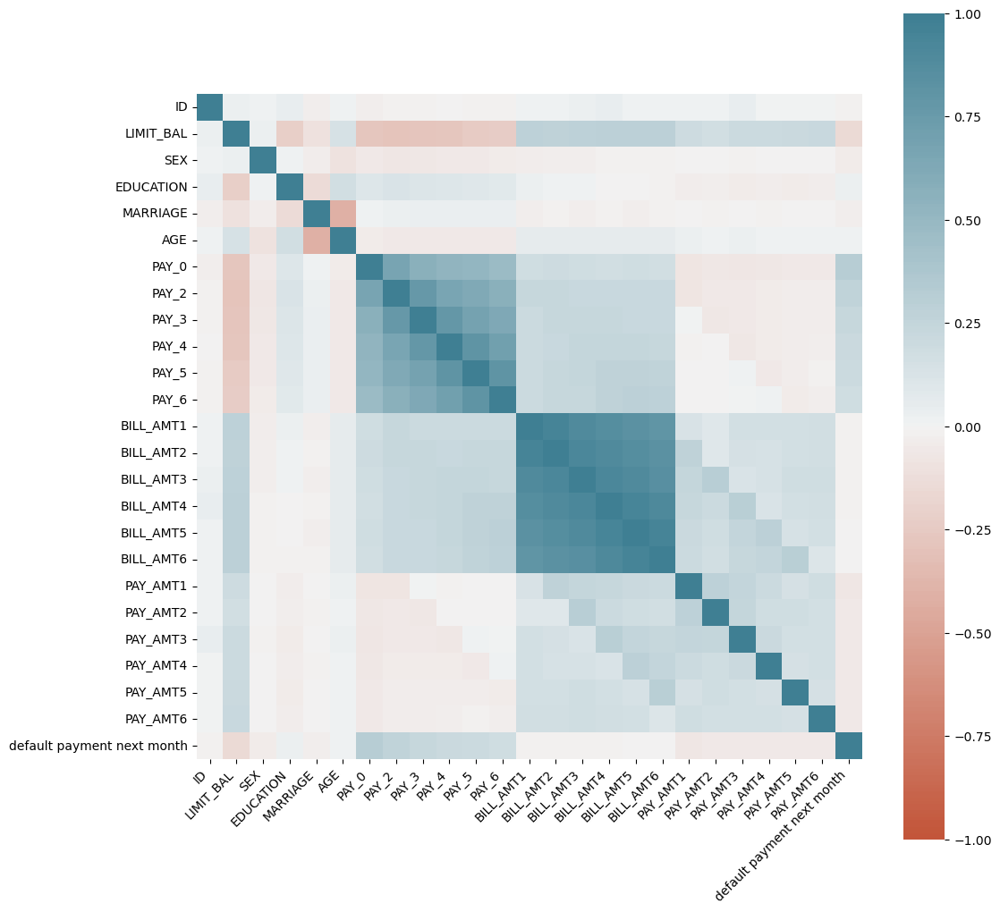

In [10]:
correlation_data(raw_data)

In [11]:
def calculate_vif(X,threshold=12.0):
    vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    for i, v in enumerate(vif):
        if v > threshold:
            print(f'VIF for variable {X.columns[i]}: {v}')

In [12]:
calculate_vif(raw_data)

VIF for variable BILL_AMT1: 20.844042295880307
VIF for variable BILL_AMT2: 38.22808248204284
VIF for variable BILL_AMT3: 31.78333010024126
VIF for variable BILL_AMT4: 29.69978758865143
VIF for variable BILL_AMT5: 36.07861319493973
VIF for variable BILL_AMT6: 21.4275958783812


In [13]:
def circle(result):
        r = 1
        d = 10 * r * (1 - result)
        circle1=plt.Circle((0, 0), r, alpha=.2)
        circle2=plt.Circle((d, 0), r, alpha=.2)
        plt.ylim([-1.1, 1.1])
        plt.xlim([-1.1, 1.1 + d])
        fig = plt.gcf()
        fig.gca().add_artist(circle1)
        fig.gca().add_artist(circle2)

In [14]:
def cosine_similarity(df,n,lower_limit,upper_limit):
    for i in np.arange(lower_limit,upper_limit):
        result = 1 - spatial.distance.cosine(df[n], df.iloc[:,i])
        print ('cosine distance between {}  and {}'.format(n,df.columns[i]), result)
        circle(result)

cosine distance between PAY_AMT1  and PAY_AMT1 1
cosine distance between PAY_AMT1  and PAY_AMT2 0.34224274160191315
cosine distance between PAY_AMT1  and PAY_AMT3 0.3208232843944705
cosine distance between PAY_AMT1  and PAY_AMT4 0.27571099234892493
cosine distance between PAY_AMT1  and PAY_AMT5 0.2309834968874257
cosine distance between PAY_AMT1  and PAY_AMT6 0.25972149024513647


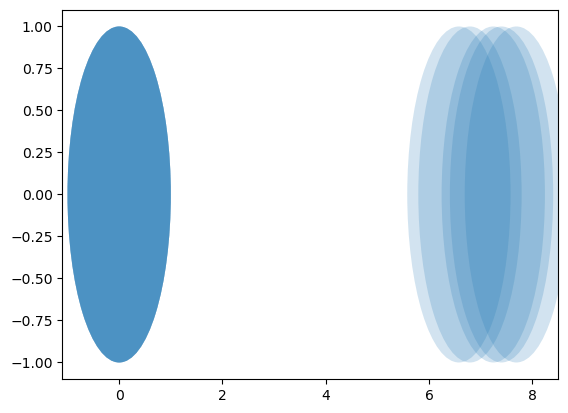

In [15]:
cosine_similarity(raw_data,'PAY_AMT1',18,24)

cosine distance between BILL_AMT1  and BILL_AMT1 1
cosine distance between BILL_AMT1  and BILL_AMT2 0.9672288987843305
cosine distance between BILL_AMT1  and BILL_AMT3 0.9267324088262381
cosine distance between BILL_AMT1  and BILL_AMT4 0.904693255417323
cosine distance between BILL_AMT1  and BILL_AMT5 0.8832902750921946
cosine distance between BILL_AMT1  and BILL_AMT6 0.8639006965838157


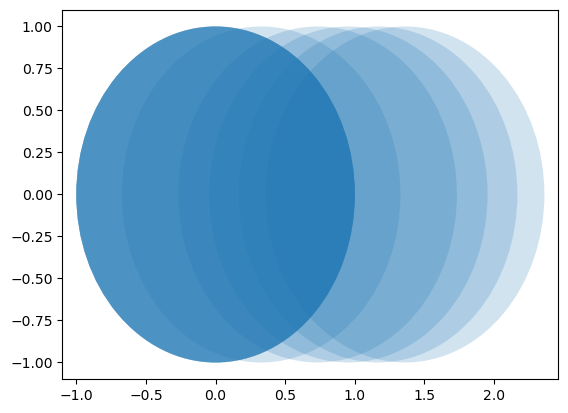

In [16]:
cosine_similarity(raw_data,'BILL_AMT1',12,18)

In [17]:
dp_limit_bal = raw_data.copy(deep =True)

In [18]:
sensitivity = ((raw_data['LIMIT_BAL'][raw_data['LIMIT_BAL'] >= raw_data['LIMIT_BAL'].mean()]).max())/(len(raw_data)+1)
print(sensitivity)

33.332222259258025


In [19]:
original = raw_data['LIMIT_BAL']

dp_limit_bal=[]
epsilon_count=[]
count=[]

for j in range (1,6):
    epsilon = j/10

    for i in range(0, 101):
        value = raw_data['LIMIT_BAL'] + np.random.laplace(loc=0, scale=sensitivity/epsilon)
        dp_limit_bal.append(value)
        print(dp_limit_bal)
        epsilon_count.append(epsilon)
        count.append(i)
        

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64]
[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64]
[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

[0         20489.5821
1        120489.5821
2         90489.5821
3         50489.5821
4         50489.5821
            ...     
29995    220489.5821
29996    150489.5821
29997     30489.5821
29998     80489.5821
29999     50489.5821
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19725.34246
1        119725.34246
2         89725.34246
3         49725.34246
4         49725.34246
             ...     
29995    219725.34246
29996    149725.34246
29997     29725.34246
29998     79725.34246
29999     49725.34246
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19406.455591
1        119406.455591
2         89406.455591
3         49406.455591
4         49406.455591
             ...      
29995    219406.455591
29996    149406.455591
29997     29406.455591
29998     79406.455591
29999     49406.455591
Name: LIMIT_BAL, Length: 30000, dtype: float64, 0         19962.16194
1        119962.16194
2         89962.16194
3         49962.16194
4         49962.16194
             ...   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [20]:
fra = pd.DataFrame({'dp_limit_bal':dp_limit_bal, 'epsilon_count':epsilon_count, 'count':count})

In [21]:
fra

,dp_limit_bal,epsilon_count,count
0,0 20489.5821 1 120489.5821 2 ...,0.1,0
1,0 19725.34246 1 119725.34246 2 ...,0.1,1
2,0 19406.455591 1 119406.455591 ...,0.1,2
3,0 19962.16194 1 119962.16194 2 ...,0.1,3
4,0 19884.450468 1 119884.450468 ...,0.1,4
...,...,...,...
500,0 19943.565375 1 119943.565375 ...,0.5,96
501,0 19824.658256 1 119824.658256 ...,0.5,97
502,0 19951.386511 1 119951.386511 ...,0.5,98
503,0 19869.774386 1 119869.774386 ...,0.5,99


In [22]:
# fig, ax = plt.subplots(figsize=(20,10))
# for name, group in fra.groupby('epsilon_count'):
#     print(group['dp_limit_bal'].shape[0])
    
#     for i in (group['dp_limit_bal']):
#         print(i)
   
#         group.plot('count', y=i, ax=ax, label=name)
# plt.axhline(y=original, color='black', linestyle='-.')

# plt.show()

In [23]:
dp_limit_bal = raw_data.copy(deep =True)
dp_limit_bal.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [24]:
#noise to AppliedAmount column

epsilon =0.5
dp_LIMIT_BAL=[]

original = raw_data['LIMIT_BAL']

for i in range(0,30000):
        value=original[i] +  np.random.laplace(loc=0, scale=sensitivity/epsilon)
        value = round(value)
        dp_LIMIT_BAL.append(value)
dp_limit_bal['LIMIT_BAL']=dp_LIMIT_BAL

In [25]:
dp_limit_bal_1 = raw_data.copy(deep =True)
dp_limit_bal_1.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [26]:
dp_LIMIT_BAL=[]
epsilon=0.5
original = raw_data['LIMIT_BAL']

    
for i in range(0,30000):
        value=original[i] +  np.random.laplace(loc=0, scale=sensitivity/epsilon)
        value = round(value)
        dp_LIMIT_BAL.append(value)
dp_limit_bal_1['LIMIT_BAL']=dp_LIMIT_BAL


In [27]:
dp_limit_bal['LIMIT_BAL']

0         19991
1        119952
2         89881
3         49944
4         49908
          ...  
29995    220062
29996    149971
29997     29967
29998     79985
29999     49727
Name: LIMIT_BAL, Length: 30000, dtype: int64

In [28]:
raw_data['LIMIT_BAL']

0         20000
1        120000
2         90000
3         50000
4         50000
          ...  
29995    220000
29996    150000
29997     30000
29998     80000
29999     50000
Name: LIMIT_BAL, Length: 30000, dtype: int64

In [29]:
dp_limit_bal

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,19991,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,119952,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,89881,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,49944,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,49908,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220062,1,3,1,39,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,149971,1,3,2,43,-1,-1,-1,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,29967,1,2,2,37,4,3,2,-1,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,79985,1,3,1,41,1,-1,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [30]:
raw_data

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,1,3,1,39,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,1,3,2,43,-1,-1,-1,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,1,2,2,37,4,3,2,-1,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,1,3,1,41,1,-1,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [31]:
raw_data.describe()['LIMIT_BAL']

count      30000.000000
mean      167484.322667
std       129747.661567
min        10000.000000
25%        50000.000000
50%       140000.000000
75%       240000.000000
max      1000000.000000
Name: LIMIT_BAL, dtype: float64

In [32]:
dp_limit_bal.describe()['LIMIT_BAL']

count     30000.000000
mean     167483.877733
std      129747.517297
min        9416.000000
25%       50152.000000
50%      140015.000000
75%      239967.000000
max      999939.000000
Name: LIMIT_BAL, dtype: float64